In [1]:
%load_ext lab_black

In [2]:
import io
import json
from datetime import date

import altair as alt
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import requests
from sklearn.cluster import SpectralClustering
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import pairwise_distances_argmin
from tslearn.clustering import KShape
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

alt.data_transformers.disable_max_rows()

C:\Users\AbboodA\AppData\Local\Continuum\miniconda3\envs\reporting\lib\site-packages\tslearn\bases\bases.py:15: UserWarning: h5py not installed, hdf5 features will not be supported.
Install h5py to use hdf5 features: http://docs.h5py.org/
  warn(h5py_msg)


DataTransformerRegistry.enable('default')

In [4]:
def load_country_codes() -> pd.DataFrame:
    response_countries = requests.get(
        "https://raw.githubusercontent.com/lukes/ISO-3166-Countries-with-Regional-Codes/master/all/all.csv",
        proxies={"https": PROXY},
    )
    # Additional country codes taken from https://covid19.who.int/info/
    return (
        pd.read_csv(io.StringIO(response_countries.text), keep_default_na=False)
        .loc[:, ["name", "alpha-2"]]
        .append(
            pd.DataFrame(
                {
                    "alpha-2": ["XA", "XB", "XC", "XK"],
                    "name": ["Bonaire", "Sint Eustatius", "Saba", "Kosovo"],
                }
            )
        )
    )

In [5]:
def load_data() -> pd.DataFrame:
    """Loads data from WHO's COVID-19 dashboard transforms it.

    Returns:
        pd.DataFrame: Loaded and transformed COVID-19 data in long format.
    """
    response = requests.get(
        "https://covid19.who.int/who-data/countries-by-day.json",
        proxies={"https": PROXY},
    )
    who_json = json.loads(response.content.decode("utf-8"))
    columns = who_json["dimensions"] + who_json["metrics"]
    columns = [column["name"] for column in columns]

    country_df = load_country_codes()

    return (
        pd.DataFrame(who_json["rows"], columns=columns)
        .astype(
            {
                "Country": "string",
                "Region": "string",
            }
        )
        .assign(day=lambda x: pd.to_datetime(x.day / 1000, unit="s"))
        .query(
            "day != @pd.to_datetime(@date.today())"
        )  # Current day is not complete yet
        .rename(columns={"Country": "ISO2"})
        .dropna()  # Removes 'other' countries that have no ISO2 code
        .sort_values(by=["day", "ISO2"])
        .reset_index(drop=True)
        .merge(
            country_df, left_on="ISO2", right_on="alpha-2", how="left", validate="m:1"
        )
    )

In [6]:
df = load_data()

In [7]:
df.ISO2.nunique()

236

In [8]:
# Remove countries that did not report any cases
no_reports = (
    df.groupby("name").agg({"Confirmed": "sum"}).query("Confirmed==0").index.values
)
df = df[~df["name"].isin(no_reports)]
print(
    f"Removed {'; '.join(list(no_reports))} from dataframe since they never reported cases."
)
# df = df.query("day>@pd.to_datetime('2020-06-01')").reset_index(drop=True)

Removed American Samoa; Cook Islands; Kiribati; Korea (Democratic People's Republic of); Micronesia (Federated States of); Nauru; Niue; Palau; Pitcairn; Saint Helena, Ascension and Tristan da Cunha; Tokelau; Tonga; Turkmenistan; Tuvalu from dataframe since they never reported cases.


In [9]:
def cluster(array: np.array) -> np.array:
    """Clusters values in 1-D array into two groups."""
    min_centroid = array.min()
    max_centroid = array.max()
    centers = np.array(
        [
            max_centroid,
            min_centroid,
        ]
    )

    while True:
        labels = pairwise_distances_argmin(array.reshape(-1, 1), centers.reshape(-1, 1))

        new_centers = np.array([array[labels == i].mean(0) for i in range(2)])

        if np.all(centers == new_centers):
            break
        centers = new_centers
    return labels

In [10]:
day_stat = df.assign(
    reported=lambda x: np.where(x["Confirmed"] > 0, 1, 0),
    weekday=lambda x: x["day"].dt.weekday,
    week=lambda x: x["day"].dt.isocalendar().week,
).loc[
    :,
    ["Region", "Confirmed", "ISO2", "reported", "day", "weekday", "week", "WkCasePop"],
]

In [11]:
day_stat.head()

,Region,Confirmed,ISO2,reported,day,weekday,week,WkCasePop
0,EURO,0,AD,0,2020-01-03,4,1,0.0
1,EMRO,0,AE,0,2020-01-03,4,1,0.0
2,EMRO,0,AF,0,2020-01-03,4,1,0.0
3,AMRO,0,AG,0,2020-01-03,4,1,0.0
4,AMRO,0,AI,0,2020-01-03,4,1,0.0


In [37]:
global_reporting = (
    day_stat.query("Region.notna()")
    .groupby(["ISO2", "weekday"])
    .agg({"reported": "mean"})
    .reset_index()
)
error_bars = (
    alt.Chart(global_reporting)
    .mark_errorbar(extent="stdev")
    .encode(y=alt.Y("reported", scale=alt.Scale(zero=False)), x=alt.X("weekday:N"))
).properties(width=400, height=400)

points = (
    alt.Chart(global_reporting)
    .mark_point(filled=True, color="black")
    .encode(
        x=alt.X(
            "weekday:N",
        ),
        y=alt.Y("reported", aggregate="mean", title="Average reporting rate"),
    )
).properties(width=400, height=400)

global_reporting_plot = (error_bars + points).properties(
    title="Global reporting rate per weekday"
)
# global_reporting_plot.save("figures/global_reporting_rate.png", webdriver="firefox")
global_reporting_plot

alt.LayerChart(...)

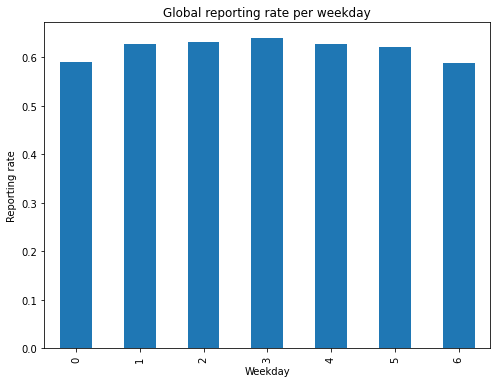

In [25]:
figure, ax = plt.subplots()
figure.set_size_inches(8, 6)
(
    day_stat.query("Region.notna()")
    .groupby(["ISO2", "weekday"])
    .agg({"reported": "mean"})
    .reset_index()
    .groupby("weekday")
    .agg({"reported": "mean"})
).plot(kind="bar", ax=ax)
ax.set_ylabel("Reporting rate")
ax.set_xlabel("Weekday")
ax.set_title("Global reporting rate per weekday")
ax.legend([], [], frameon=False)
plt.savefig("figures/binary_stat_world_weekady.png")
plt.show()

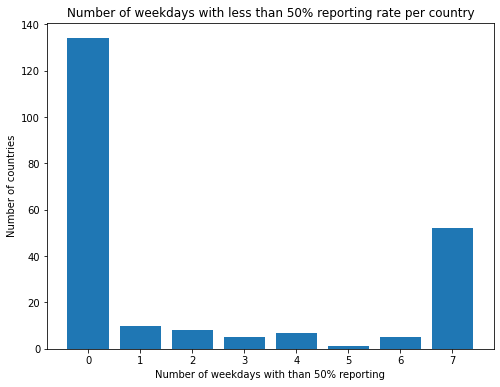

In [12]:
report_behavior_binarized = (
    day_stat.query("Region.notna()")
    .groupby(["ISO2", "weekday"])
    .agg({"reported": "mean"})
    .reset_index()
    .assign(reported=lambda x: x["reported"] < 0.5)
)

bin_, counts = np.unique(
    (report_behavior_binarized.groupby("ISO2").agg({"reported": "sum"}).values),
    return_counts=True,
)

figure, ax = plt.subplots()
figure.set_size_inches(8, 6)
ax.bar(bin_, counts)
ax.set_ylabel("Number of countries")
ax.set_xlabel("Number of weekdays with than 50% reporting")
ax.set_title("Number of weekdays with less than 50% reporting rate per country")
# plt.savefig("figures/binary_stat_world_weekady_2.png")
plt.show()

In [14]:
region_incidence = (
    alt.Chart(
        day_stat.query("Region.notna()").loc[:, ["weekday", "Region", "WkCasePop"]]
    )
    .mark_line(point=True)
    .encode(
        x="weekday:N",
        y=alt.Y("mean(WkCasePop)", title="Average 7-day incidence"),
        color="Region",
    )
).properties(width=400, height=400)

region_reporting = (
    alt.Chart(
        day_stat.query("Region.notna()").loc[:, ["weekday", "Region", "reported"]]
    )
    .mark_line(point=True)
    .encode(
        x="weekday:N",
        y=alt.Y("mean(reported)", title="Average reporting rate"),
        color="Region",
    )
).properties(width=400, height=400)

region_inc_report_bin = alt.hconcat(region_incidence, region_reporting).properties(
    title="Comparison of reporting behavior and 7-days incidence per region and weekday"
)
# region_inc_report_bin.save("figures/comparison_region.png", webdriver="firefox")
region_inc_report_bin

alt.HConcatChart(...)

In [17]:
countries = (
    day_stat.query("Region.notna()")
    .loc[:, ["weekday", "ISO2", "WkCasePop", "reported"]]
    .groupby(["ISO2", "weekday"])
    .agg({"WkCasePop": "mean", "reported": "mean"})
    .assign(
        incidence=lambda x: MinMaxScaler().fit_transform(
            x["WkCasePop"].values.reshape(-1, 1)
        ),
        score=lambda x: x["reported"] - x["incidence"],
    )
    .reset_index()
    .groupby("ISO2")
    .agg({"score": "mean"})
    .sort_values(by="score", ascending=False)
    .merge(
        df.loc[:, ["ISO2", "name"]].drop_duplicates(),
        left_index=True,
        right_on="ISO2",
        how="left",
    )
)

Text(0.5, 1.0, 'Reporting score distribution')

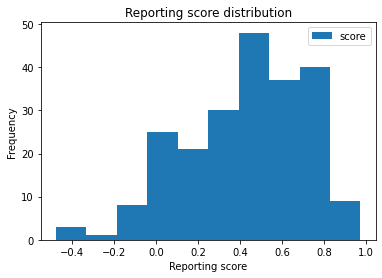

In [18]:
ax = countries.plot(y="score", kind="hist")
ax.set_xlabel("Reporting score")
ax.set_title("Reporting score distribution")
# plt.savefig("figures/reporting_score_dis.png")

In [19]:
comp_df = (
    day_stat.query("Region.notna()")
    .loc[:, ["weekday", "ISO2", "WkCasePop", "reported"]]
    .groupby(["ISO2", "weekday"])
    .agg({"WkCasePop": "mean", "reported": "mean"})
    .reset_index()
)

In [20]:
plots = []
for iso in list(countries.ISO2[:1].values) + list(countries.ISO2[-1:].values):
    inc = (
        alt.Chart(comp_df.query("ISO2==@iso"))
        .mark_point(filled=True, size=66)
        .encode(x="weekday:N", y=alt.Y("WkCasePop", title="7-day-incidence"))
    ).properties(title=iso, width=400, height=400)
    rep = (
        alt.Chart(comp_df.query("ISO2==@iso"))
        .mark_point(filled=True, size=66)
        .encode(x="weekday:N", y=alt.Y("reported", title="Average reporting rate"))
    ).properties(width=400, height=400)
    plots.append(alt.hconcat(inc, rep))

In [21]:
top_1_bottom_1 = alt.vconcat(*plots)

In [22]:
# top_1_bottom_1.save("figures/reporting_score_top_bottom_1.png", webdriver="firefox")
top_1_bottom_1

alt.VConcatChart(...)

In [23]:
error_bars = (
    alt.Chart()
    .mark_errorbar(extent="stdev", clip=True)
    .encode(
        x=alt.X("weekday:N"),
        y=alt.Y("reported", scale=alt.Scale(domain=[0, 1])),
    )
)

points = (
    alt.Chart()
    .mark_point(filled=True)
    .encode(
        x=alt.X("weekday:N"),
        y=alt.Y("mean(reported)", scale=alt.Scale(domain=[0, 1])),
    )
)

line = (
    alt.Chart(pd.DataFrame({"reported": [0.5]}))
    .mark_rule(color="red")
    .encode(y="reported")
)

alt.layer(
    points,
    error_bars,
    line,
    data=day_stat.query("Region.notna()").loc[:, ["weekday", "Region", "reported"]],
).facet("Region:N", columns=3)

alt.FacetChart(...)

In [24]:
# Plot too large

# plots = []
# for region in ["AFRO", "AMRO", "EMRO", "EURO", "SEARO", "WPRO"]:
#     error_bars = (
#         alt.Chart()
#         .mark_errorbar(extent="stdev", clip=True)
#         .encode(
#             x=alt.X("weekday:N"),
#             y=alt.Y("reported", scale=alt.Scale(domain=[0, 1])),
#         )
#     )
#     points = (
#         alt.Chart()
#         .mark_point(filled=True, color="black")
#         .encode(
#             x=alt.X("weekday:N"),
#             y=alt.Y("mean(reported)", scale=alt.Scale(domain=[0, 1])),
#         )
#     )
#     line = (
#         alt.Chart(pd.DataFrame({"reported": [0.5]}))
#         .mark_rule(color="red")
#         .encode(y="reported")
#     )
#     plots.append(
#         alt.layer(points, error_bars, line, data=day_stat.query(f"Region=='{region}'"))
#         .facet("ISO2:N", columns=6)
#         .properties(title=region)
#     )
# alt.vconcat(*plots)

In [25]:
SEED = 19

0.074 --> 0.067 --> 0.069 --> 


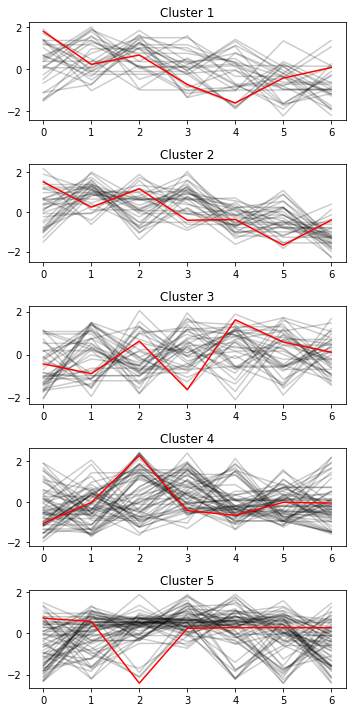

In [26]:
X_train_raw = np.vstack(
    list(
        day_stat.query("Region.notna()")
        .groupby(["ISO2", "weekday"])
        .agg({"reported": "mean"})
        .reset_index()
        .groupby(["ISO2"])["reported"]
        .apply(np.array)
        .values
    )
).reshape(-1, 7, 1)

# For this method to operate properly, prior scaling is required
X_train = TimeSeriesScalerMeanVariance().fit_transform(X_train_raw)
sz = X_train.shape[1]

clusters = 5
ks = KShape(n_clusters=clusters, verbose=True, random_state=SEED)
y_pred = ks.fit_predict(X_train)

f, axs = plt.subplots(2, 2, figsize=(5, 10))
for yi in range(clusters):
    plt.subplot(clusters, 1, 1 + yi)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=0.2)
    plt.plot(ks.cluster_centers_[yi].ravel(), "r-")
    plt.title("Cluster %d" % (yi + 1))

plt.tight_layout()
plt.show()

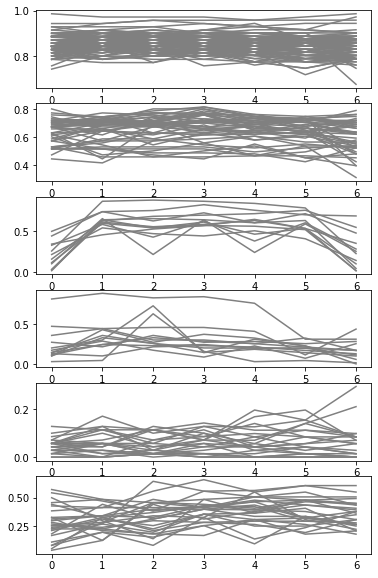

In [27]:
binary_stat = (
    day_stat.groupby(["ISO2", "weekday"])
    .agg({"reported": "mean"})
    .groupby("ISO2")["reported"]
    .apply(np.array)
)

binary_stat_iso2 = binary_stat.index

binary_stat_mat = np.vstack(list(binary_stat.values))

n_clusters = 6
clustering = SpectralClustering(
    n_clusters=n_clusters, assign_labels="discretize", random_state=SEED
)
clustering.fit(binary_stat_mat)

fig, axs = plt.subplots(n_clusters)
fig.set_size_inches(6, 10)
for cluster in range(n_clusters):
    for cluster_arr in np.argwhere(clustering.labels_ == cluster).ravel():
        axs[cluster].plot(range(7), binary_stat_mat[cluster_arr], color="grey")
plt.savefig("figures/clustering_binary_reporting.png")

In [28]:
binary_stat.iloc[np.argwhere(clustering.labels_ == 2).ravel()].index

Index(['AD', 'AW', 'CW', 'GA', 'GF', 'GU', 'NO', 'PF', 'RE', 'SM', 'SX', 'YT'], dtype='object', name='ISO2')

In [29]:
df.loc[:, ["ISO2", "name"]].drop_duplicates().query(
    "ISO2.isin(['AD', 'AW', 'CW', 'GA', 'GF', 'GU', 'NO', 'PF', 'RE', 'SM', 'SX', 'YT'])"
)

,ISO2,name
0,AD,Andorra
12,AW,Aruba
47,CW,Curaçao
68,GA,Gabon
72,GF,French Guiana
83,GU,Guam
153,NO,Norway
161,PF,French Polynesia
174,RE,Réunion
189,SM,San Marino


## Proportion of new cases along weekdays

In [61]:
weekday_stat_reg = (
    day_stat.groupby(["Region", "ISO2", "week", "weekday"])
    .agg({"Confirmed": "sum"})
    .reset_index()
)
weekday_stat_reg = weekday_stat_reg.assign(
    confirmed_relative=lambda x: x["Confirmed"]
    / x.groupby(["Region", "ISO2", "week"])["Confirmed"].transform("sum")
)

In [31]:
weekday_stat_reg.head()

,Region,ISO2,week,weekday,Confirmed,confirmed_relative
0,AFRO,AO,1,0,34,0.062044
1,AFRO,AO,1,1,42,0.076642
2,AFRO,AO,1,2,0,0.000000
3,AFRO,AO,1,3,180,0.328467
4,AFRO,AO,1,4,110,0.200730


In [32]:
error_bars = (
    alt.Chart()
    .mark_errorbar(extent="stdev", clip=True)
    .encode(
        x=alt.X("weekday:N"),
        y=alt.Y("confirmed_relative"),
    )
)

points = (
    alt.Chart()
    .mark_point(filled=True)
    .encode(
        x=alt.X("weekday:N"),
        y=alt.Y(
            "mean(confirmed_relative)",
        ),
    )
)


alt.layer(
    points,
    error_bars,
    data=weekday_stat_reg.query("Region.notna() and Region!='OTHER'").loc[
        :, ["weekday", "Region", "confirmed_relative"]
    ],
).properties(width=400, height=400)

alt.LayerChart(...)

In [33]:
selection = alt.selection_multi(fields=["Region"], bind="legend")
(
    alt.Chart(
        weekday_stat_reg.query("Region.notna() and Region!='OTHER'").loc[
            :, ["weekday", "Region", "confirmed_relative"]
        ]
    )
    .mark_line(point=True)
    .encode(
        x="weekday:N",
        y="mean(confirmed_relative)",
        color="Region",
        opacity=alt.condition(selection, alt.value(1), alt.value(0.2)),
    )
).add_selection(selection).properties(width=500, height=500)

alt.Chart(...)

In [34]:
error_bars = (
    alt.Chart()
    .mark_errorbar(extent="stdev", clip=True)
    .encode(
        x=alt.X("weekday:N"),
        y=alt.Y("confirmed_relative"),
    )
)

points = (
    alt.Chart()
    .mark_point(filled=True)
    .encode(
        x=alt.X("weekday:N"),
        y=alt.Y("mean(confirmed_relative)"),
    )
)


alt.layer(
    points,
    error_bars,
    data=weekday_stat_reg.query("Region.notna() and Region!='OTHER'").loc[
        :, ["weekday", "Region", "confirmed_relative"]
    ],
).facet("Region:N", columns=3)

alt.FacetChart(...)

In [35]:
# PLot too large

# plots = []
# for region in ['AFRO', 'AMRO', 'EMRO', 'EURO', 'SEARO', 'WPRO']:
#     error_bars = alt.Chart().mark_errorbar(extent='stdev', clip=True).encode(
#         x=alt.X("weekday:N"),
#         y=alt.Y("confirmed_relative"),
#     )

#     points = alt.Chart().mark_point(filled=True).encode(
#         x=alt.X("weekday:N"),
#         y=alt.Y("mean(confirmed_relative)", scale=alt.Scale(domain=[0,1])),
#     )


#     plots.append(alt.layer(points, error_bars, data=weekday_stat_reg.query(f"Region=='{region}'")).facet("ISO2:N", columns=6).properties(title=region))

# alt.vconcat(*plots)

C:\Users\AbboodA\AppData\Local\Continuum\miniconda3\envs\reporting\lib\site-packages\numpy\core\fromnumeric.py:87: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


0.047 --> 0.051 --> 


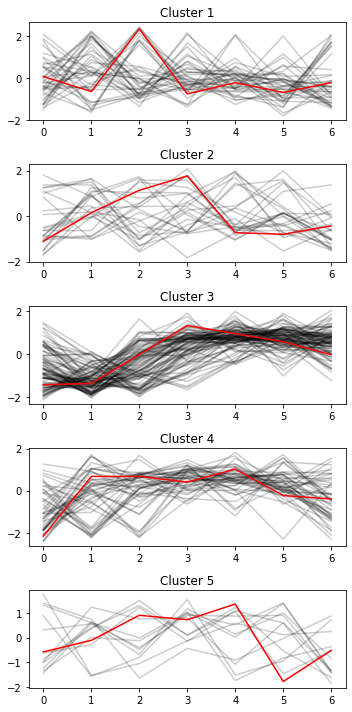

In [36]:
X_train_raw_relative = np.vstack(
    list(
        weekday_stat_reg.groupby(["ISO2", "weekday"])
        .agg({"confirmed_relative": "mean"})
        .reset_index()
        .groupby("ISO2")["confirmed_relative"]
        .apply(np.array)
        .values
    )
).reshape(-1, 7, 1)
X_train_raw_relative = X_train_raw_relative[
    np.any(np.isfinite(X_train_raw_relative), axis=1).reshape(-1)
]
# For this method to operate properly, prior scaling is required
X_train = TimeSeriesScalerMeanVariance().fit_transform(X_train_raw_relative)

clusters = 5
# kShape clustering
ks = KShape(n_clusters=clusters, verbose=True, random_state=SEED)
X_train = X_train[np.any(np.isfinite(X_train), axis=1).reshape(-1)]
y_pred = ks.fit_predict(X_train)

f, axs = plt.subplots(2, 2, figsize=(5, 10))
for yi in range(clusters):
    plt.subplot(clusters, 1, 1 + yi)
    for xx in X_train[y_pred == yi]:
        plt.plot(xx.ravel(), "k-", alpha=0.2)
    plt.plot(ks.cluster_centers_[yi].ravel(), "r-")
    plt.title("Cluster %d" % (yi + 1))

plt.tight_layout()
plt.show()

In [42]:
clusters = []
for arr in X_train_raw:
    try:
        clusters.append(cluster(arr))
    except:
        continue

uniques = np.unique(clusters, axis=0)
print(uniques.shape)
uniques.shape[0] / 2 ** 7

(89, 7)


0.6953125

In [43]:
clusters = []
for arr in X_train_raw_relative:
    try:
        clusters.append(cluster(arr))
    except:
        continue

uniques = np.unique(clusters, axis=0)
print(uniques.shape)
uniques.shape[0] / 2 ** 7

(71, 7)


C:\Users\AbboodA\AppData\Local\Continuum\miniconda3\envs\reporting\lib\site-packages\numpy\core\fromnumeric.py:87: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\AbboodA\AppData\Local\Continuum\miniconda3\envs\reporting\lib\site-packages\numpy\core\fromnumeric.py:87: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
C:\Users\AbboodA\AppData\Local\Continuum\miniconda3\envs\reporting\lib\site-packages\numpy\core\fromnumeric.py:87: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


0.5546875

In [58]:
day_stat

,Region,Confirmed,ISO2,reported,day,weekday,week,WkCasePop
86140,EURO,68,AD,1,2021-01-02,5,53,467.22
86141,EMRO,1856,AE,1,2021-01-02,5,53,101.24
86142,EMRO,73,AF,1,2021-01-02,5,53,2.11
86143,AMRO,0,AG,0,2021-01-02,5,53,5.11
86144,AMRO,1,AI,1,2021-01-02,5,53,20.00
...,...,...,...,...,...,...,...,...
116343,EMRO,16,YE,1,2021-05-09,6,18,0.46
116344,AFRO,0,YT,0,2021-05-09,6,18,14.66
116345,AFRO,2191,ZA,1,2021-05-09,6,18,20.19
116346,AFRO,53,ZM,1,2021-05-09,6,18,2.11


In [59]:
weekday_stat_reg = (
    day_stat.query("day>@pd.to_datetime('2021-01-01')")
    .groupby(["Region", "ISO2", "week", "weekday"])
    .agg({"Confirmed": "sum"})
    .reset_index()
)
weekday_stat_reg = weekday_stat_reg.assign(
    confirmed_relative=lambda x: x["Confirmed"]
    / x.groupby(["Region", "ISO2", "week"])["Confirmed"].transform("sum")
)

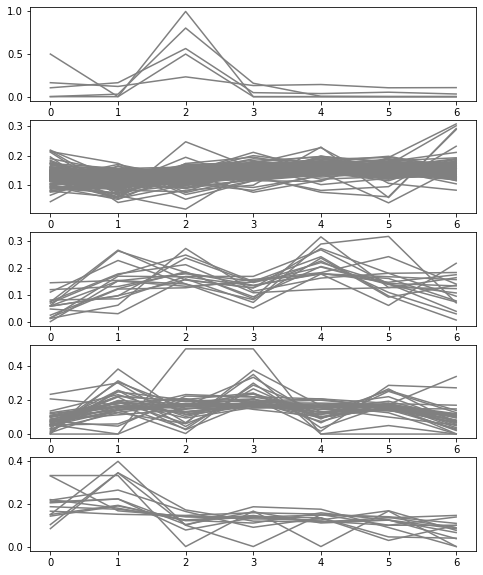

In [62]:
relative_stat = (
    weekday_stat_reg.groupby(["ISO2", "weekday"])
    .agg({"confirmed_relative": "mean"})
    .groupby("ISO2")["confirmed_relative"]
    .apply(np.array)
)
relative_stat_iso2 = relative_stat.index
relative_stat_mat = np.vstack(list(relative_stat.values))
is_finite = np.argwhere(np.isfinite(relative_stat_mat).all(axis=1)).ravel()
relative_stat_mat = relative_stat_mat[is_finite]

n_clusters = 5
clustering = SpectralClustering(
    n_clusters=n_clusters, assign_labels="discretize", random_state=SEED
)
clustering.fit(relative_stat_mat)

fig, axs = plt.subplots(n_clusters)
fig.set_size_inches(8, 10)
for cluster in range(n_clusters):
    for cluster_arr in np.argwhere(clustering.labels_ == cluster).ravel():
        axs[cluster].plot(range(7), relative_stat_mat[cluster_arr], color="grey")
# plt.savefig("figures/relative_reporting_clustering.png")

In [63]:
relative_stat.iloc[np.argwhere(clustering.labels_ == 3).ravel()].index

Index(['AD', 'AW', 'BE', 'BG', 'BN', 'CF', 'CG', 'CH', 'CY', 'CZ', 'DE', 'FI',
       'FJ', 'FR', 'GL', 'GN', 'GT', 'KM', 'KY', 'KZ', 'LC', 'LR', 'MA', 'MG',
       'MP', 'NI', 'PA', 'PY', 'SA', 'SS', 'TG', 'TN', 'US', 'UY', 'VA', 'VE',
       'WF'],
      dtype='object', name='ISO2')

In [64]:
df.loc[:, ["ISO2", "name"]].drop_duplicates().query(
    "ISO2.isin(['AD', 'AW', 'BE', 'BG', 'BN', 'CF', 'CG', 'CH', 'CY', 'CZ', 'DE', 'FI','FJ', 'FR', 'GL', 'GN', 'GT', 'KM', 'KY', 'KZ', 'LC', 'LR', 'MA', 'MG','MP', 'NI', 'PA', 'PY', 'SA', 'SS', 'TG', 'TN', 'US', 'UY', 'VA', 'VE','WF'])"
)

,ISO2,name
0,AD,Andorra
12,AW,Aruba
17,BE,Belgium
19,BG,Bulgaria
25,BN,Brunei Darussalam
35,CF,Central African Republic
36,CG,Congo
37,CH,Switzerland
48,CY,Cyprus
49,CZ,Czechia


## TODO:
- Produkt: Excel

Spanien | Meldet Überhaupt >50% Mo-So | Proportion aller Fälle in einer Woche Mo-So